In [3]:
#v2
#7/11/2018

dataname="bladder"

desired_mask_mpp = 4
model_mpp = 0.5 # MPP of patches to be fed into model

patch_size=256 #size of the tiles to extract and save in the database, must be >= to training size
stride_size = patch_size
test_set_size=.2 # what percentage of the dataset should be used as a held out validation/testing set
resize=1 #resize input images
class_names=[0,1] #what classes we expect to have in the data, here we have only 2 classes but we could add additional classes and/or specify an index from which we would like to ignore

#-----Note---
#One should likely make sure that  (nrow+mirror_pad_size) mod patch_size == 0, where nrow is the number of rows after resizing
#so that no pixels are lost (any remainer is ignored)


In [4]:
import torch
import tables

import os,sys
import glob

import PIL
import numpy as np
import scipy

import cv2
import matplotlib.pyplot as plt

from sklearn import model_selection
import sklearn.feature_extraction.image
import random

sys.path.insert(1,'/mnt/data/home/pjl54/WSI_handling')
import wsi

import tqdm

seed = random.randrange(sys.maxsize) #get a random seed so that we can reproducibly do the cross validation setup
random.seed(seed) # set the seed
print(f"random seed (note down for reproducibility): {seed}")

random seed (note down for reproducibility): 3122648802417378711


In [3]:
img_dtype = tables.UInt8Atom()  # dtype in which the images will be saved, this indicates that images will be saved as unsigned int 8 bit, i.e., [0,255]
filenameAtom = tables.StringAtom(itemsize=255) #create an atom to store the filename of the image, just incase we need it later, 

In [5]:
grade_key = {}
with open('/mnt/data/home/pjl54/bladder/densenet/blad_grade_key.txt') as file:
    for line in file:
        (patient, label) = line.split()
        grade_key[patient] = int(label)

In [6]:
all_files = []
for patient in grade_key.keys():
    if os.path.exists('/mnt/ccipd_data/UH_Bladder_Cancer_Project/Blad170830/' + patient):
        all_files.append('/mnt/ccipd_data/UH_Bladder_Cancer_Project/Blad170830/' + patient)
    else:
        all_files.append('/mnt/ccipd_data/UH_Bladder_Histology/May_2019/Ventana/' + patient)

# all_files=glob.glob(r'/mnt/data/home/pjl54/pesoProstateSE/imgs/*training_mask.tif')

#create training and validation stages and split the files appropriately between them
phases={}
phases["train"],phases["val"]=next(iter(model_selection.ShuffleSplit(n_splits=1,test_size=test_set_size).split(all_files)))

#specify that we'll be saving 2 different image types to the database, an image and its associated masked
imgtypes=["imgs","labels"]

In [6]:
storage={} #holder for future pytables
block_shape= np.array((patch_size,patch_size,3))

filters=tables.Filters(complevel=6, complib='zlib') #we can also specify filters, such as compression, to improve storage speed

for phase in phases.keys(): #now for each of the phases, we'll loop through the files
    print(phase)
    files = [all_files[k] for k in phases[phase]]
    
    rscs = [[] for i in range(0,len(files))]    

    osis = [wsi.wsi(img_fname = file, xml_fname = file.split('.tif')[0]+'.xml') for file in files]

    totals=np.zeros(len(class_names)) # we can to keep counts of all the classes in for in particular training, since we 

    hdf5_file = tables.open_file(f"./{dataname}_{phase}.pytable", mode='w') #open the respective pytable
    storage["filenames"] = hdf5_file.create_earray(hdf5_file.root, 'filenames', filenameAtom, (0,)) #create the array for storage
    
    storage["imgs"]= hdf5_file.create_earray(hdf5_file.root, "imgs", img_dtype,  
                                                  shape=np.append([0],block_shape), 
                                                  chunkshape=np.append([1],block_shape),
                                                  filters=filters)

    storage["labels"]= hdf5_file.create_earray(hdf5_file.root, "labels", img_dtype,  
                                              shape=[0], 
                                              chunkshape=[1],
                                              filters=filters)


    for index, wsi_img in tqdm.tqdm(enumerate(osis)):        

        stride_size_converted = wsi_img.get_coord_at_mpp(stride_size,input_mpp=wsi_img["mpps"][0],output_mpp=desired_mask_mpp)

        [mask_small, resize_factor] = wsi_img.mask_out_annotation(desired_mpp=desired_mask_mpp,colors_to_use=None)            

        mask_small = mask_small[list(range(0,np.shape(mask_small)[0],stride_size_converted)),:]            
        mask_small = mask_small[:,list(range(0,np.shape(mask_small)[1],stride_size_converted))]            

        [rs,cs]=(mask_small>0).nonzero()
        rs = [r*stride_size_converted for r in rs]
        cs = [c*stride_size_converted for c in cs]

        rs = [wsi_img.get_coord_at_mpp(r,wsi_img["mpps"][0],desired_mask_mpp) for r in rs]
        cs = [wsi_img.get_coord_at_mpp(c,wsi_img["mpps"][0],desired_mask_mpp) for c in cs]

        goods = np.ones(np.shape(rs)[0])
        for k in range(0,np.shape(rs)[0]):

            a = wsi_img.get_tile(coords=(cs[k],rs[k]),wh=(1,1),desired_mpp=desired_mask_mpp)
            if((np.sum(a>220)/np.size(a))>0.50):
                goods[k] = False             

        cs = [c for idx,c in enumerate(cs) if goods[idx]]
        rs = [r for idx,r in enumerate(rs) if goods[idx]]
        rscs[index]=(cs,rs)            
        
        classid = grade_key[wsi_img['img_fname'].split('/')[-1]]
        totals[classid]+=1


    patch_counts = [np.shape(k)[1] for k in rscs]        
#     patch_counts[0] = patch_counts[0] - 1   
    adds = [1] + patch_counts
    adds = np.cumsum(adds)
#     storage["img"] = np.ones([sum(patch_counts),patch_size,patch_size,3],dtype=np.uint8)
#     storage["mask"] = np.ones([sum(patch_counts),patch_size,patch_size],dtype=np.uint8)

    for index, wsi_img in tqdm.tqdm(enumerate(osis)):
        img_label = grade_key[wsi_img['img_fname'].split('/')[-1]]
        for rcidx in range(0,patch_counts[index]-1):            

            img = wsi_img.get_tile(desired_mpp=model_mpp,coords=(rscs[index][0][rcidx],rscs[index][1][rcidx]),wh=(patch_size,patch_size))        


            storage["imgs"].append(img.reshape(-1,patch_size,patch_size,3))
            storage["labels"].append([img_label])

        storage["filenames"].append([files[index] for x in range(patch_counts[index]-1)]) #add the filename to the storage array

    #lastely, we should store the number of pixels
    npixels=hdf5_file.create_carray(hdf5_file.root, 'classsizes', tables.Atom.from_dtype(totals.dtype), totals.shape)
    npixels[:]=totals
    hdf5_file.close()

train


40it [00:16,  2.49it/s]
40it [13:20, 20.02s/it]


val


10it [00:03,  2.58it/s]
10it [03:14, 19.47s/it]


ClosedNodeError: the node object is closed

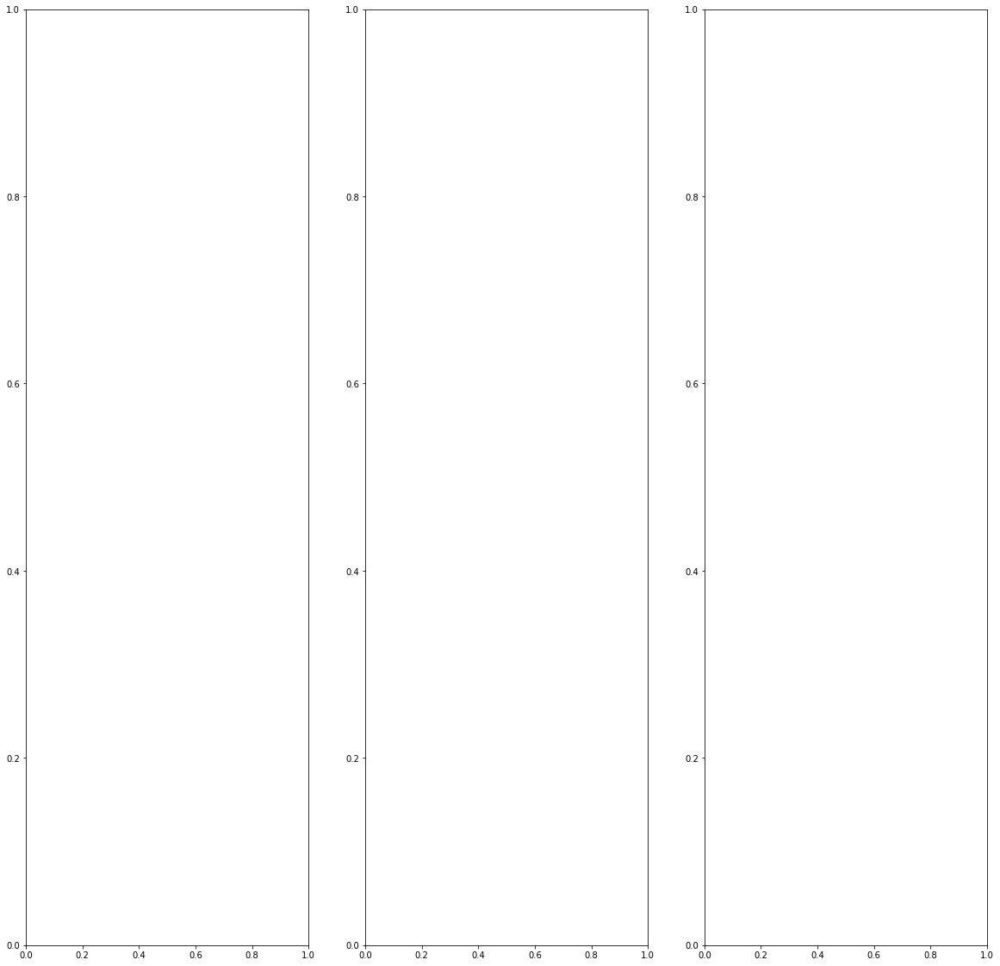

In [7]:
import matplotlib.pyplot as plt

for k in range(1,500,50):
    fig, ax = plt.subplots(1,3,figsize=(20,20))
    ax[0].imshow(storage["imgs"][k])

In [8]:
storage={} #holder for future pytables
block_shape= np.array((patch_size,patch_size,3))

filters=tables.Filters(complevel=6, complib='zlib') #we can also specify filters, such as compression, to improve storage speed

for phase in phases.keys(): #now for each of the phases, we'll loop through the files
    print(phase)
    files = [all_files[k] for k in phases[phase]]
    
    rscs = [[] for i in range(0,len(files))]    

    osis = [wsi.wsi(img_fname = file, xml_fname = file.split('.tif')[0]+'.xml') for file in files]

    totals=np.zeros(len(class_names)) # we can to keep counts of all the classes in for in particular training, since we 

    for index, wsi_img in tqdm.tqdm(enumerate(osis)):        

        stride_size_converted = wsi_img.get_coord_at_mpp(stride_size,input_mpp=wsi_img["mpps"][0],output_mpp=desired_mask_mpp)

        [mask_small, resize_factor] = wsi_img.mask_out_annotation(desired_mpp=desired_mask_mpp,colors_to_use=None)            

        mask_small = mask_small[list(range(0,np.shape(mask_small)[0],stride_size_converted)),:]            
        mask_small = mask_small[:,list(range(0,np.shape(mask_small)[1],stride_size_converted))]            

        [rs,cs]=(mask_small>0).nonzero()
        rs = [r*stride_size_converted for r in rs]
        cs = [c*stride_size_converted for c in cs]

        rs = [wsi_img.get_coord_at_mpp(r,wsi_img["mpps"][0],desired_mask_mpp) for r in rs]
        cs = [wsi_img.get_coord_at_mpp(c,wsi_img["mpps"][0],desired_mask_mpp) for c in cs]

        goods = np.ones(np.shape(rs)[0])
        for k in range(0,np.shape(rs)[0]):

            a = wsi_img.get_tile(coords=(cs[k],rs[k]),wh=(1,1),desired_mpp=desired_mask_mpp)
            if(np.all(a>220)):
                goods[k] = False             

        cs = [c for idx,c in enumerate(cs) if goods[idx]]
        rs = [r for idx,r in enumerate(rs) if goods[idx]]
        rscs[index]=(cs,rs)            
        
        classid = grade_key[wsi_img['img_fname'].split('/')[-1]]
        totals[classid]+=1


    patch_counts = [np.shape(k)[1] for k in rscs]        
#     patch_counts[0] = patch_counts[0] - 1   
    adds = [1] + patch_counts
    adds = np.cumsum(adds)
#     storage["img"] = np.ones([sum(patch_counts),patch_size,patch_size,3],dtype=np.uint8)
#     storage["mask"] = np.ones([sum(patch_counts),patch_size,patch_size],dtype=np.uint8)

    for index, wsi_img in tqdm.tqdm(enumerate(osis)):
        img_label = grade_key[wsi_img['img_fname'].split('/')[-1]]
        for rcidx in range(0,patch_counts[index]-1,100):            

            img = wsi_img.get_tile(desired_mpp=model_mpp,coords=(rscs[index][0][rcidx],rscs[index][1][rcidx]),wh=(patch_size,patch_size))        
            print(wsi_img['img_fname'].split('/')[-1])
            print(img_label)
            plt.imshow(img)
            plt.show()

train



0it [00:00, ?it/s]
1it [00:00,  1.53it/s]
2it [00:01,  1.30it/s]
3it [00:02,  1.40it/s]
4it [00:02,  1.46it/s]
6it [00:03,  1.93it/s]
7it [00:04,  1.50it/s]
8it [00:04,  1.40it/s]
9it [00:05,  1.81it/s]
10it [00:05,  2.19it/s]
11it [00:06,  1.28it/s]
12it [00:07,  1.66it/s]
13it [00:07,  1.52it/s]
14it [00:08,  1.62it/s]
15it [00:08,  1.72it/s]
16it [00:09,  2.22it/s]
17it [00:09,  1.72it/s]
19it [00:10,  1.85it/s]
20it [00:11,  1.99it/s]
21it [00:11,  2.48it/s]
22it [00:11,  2.65it/s]
23it [00:12,  2.10it/s]
24it [00:12,  2.49it/s]
25it [00:13,  1.73it/s]
26it [00:13,  2.05it/s]
27it [00:14,  2.09it/s]
28it [00:14,  2.42it/s]
29it [00:15,  1.97it/s]
30it [00:15,  2.19it/s]
31it [00:16,  1.96it/s]
32it [00:16,  2.26it/s]
33it [00:17,  2.11it/s]
34it [00:18,  1.53it/s]
35it [00:18,  1.72it/s]
36it [00:19,  1.39it/s]
37it [00:20,  1.57it/s]
38it [00:20,  1.98it/s]
39it [00:20,  2.50it/s]
40it [00:21,  1.90it/s]

0it [00:00, ?it/s]


TypeError: range() does not take keyword arguments


0it [00:00, ?it/s]

Blad_118.tif
1


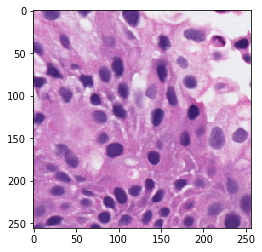

Blad_118.tif
1


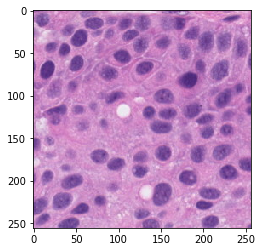

Blad_118.tif
1


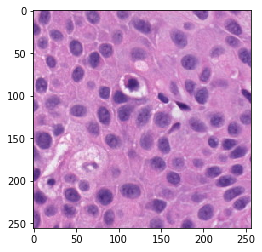

Blad_118.tif
1


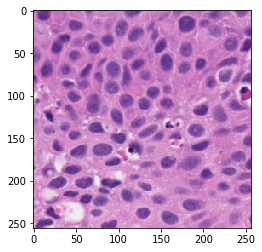

Blad_118.tif
1


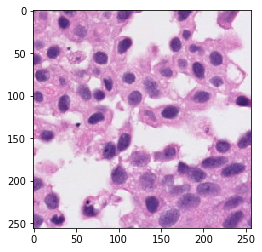

Blad_118.tif
1


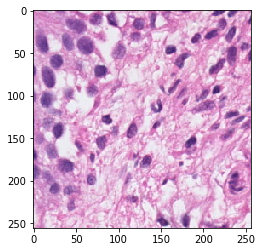

Blad_118.tif
1


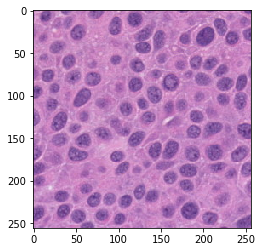

Blad_118.tif
1


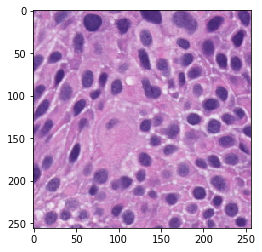

Blad_118.tif
1


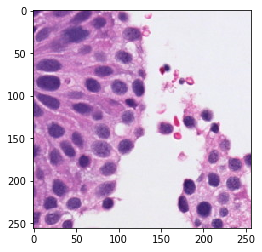

Blad_118.tif
1


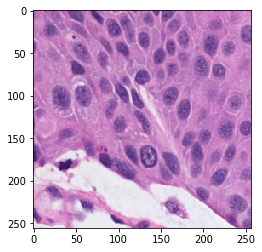

Blad_118.tif
1


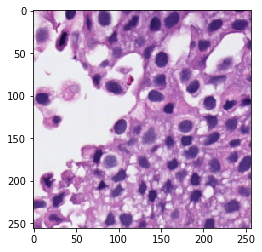

Blad_118.tif
1


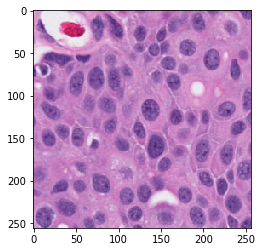

Blad_118.tif
1


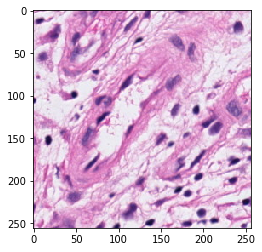

Blad_118.tif
1


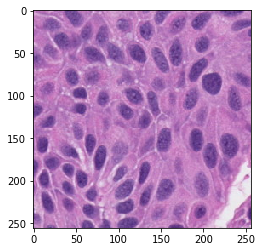

Blad_118.tif
1


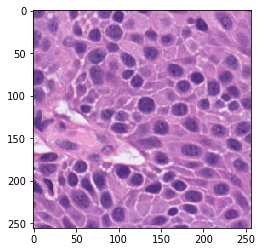

Blad_118.tif
1


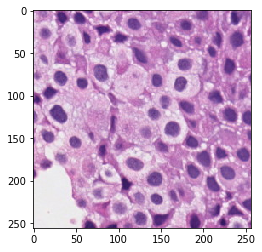

Blad_118.tif
1


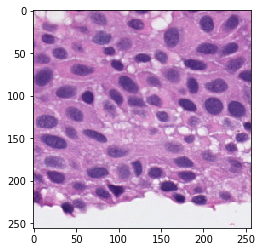


1it [00:06,  6.80s/it]

Blad_66.tif
0


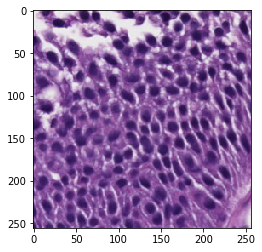

Blad_66.tif
0


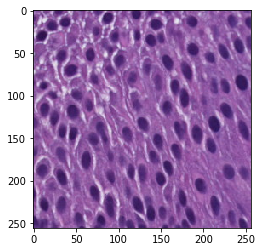

Blad_66.tif
0


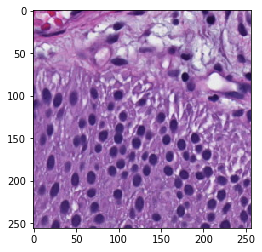

Blad_66.tif
0


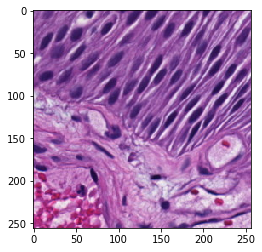

Blad_66.tif
0


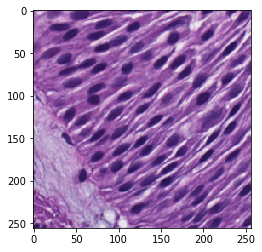

Blad_66.tif
0


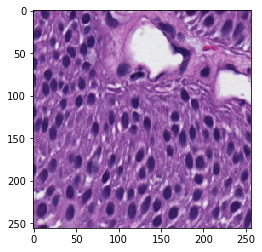

Blad_66.tif
0


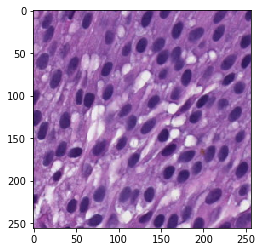

Blad_66.tif
0


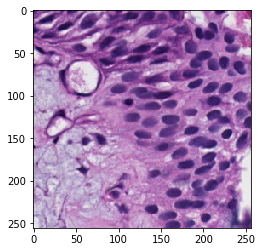

Blad_66.tif
0


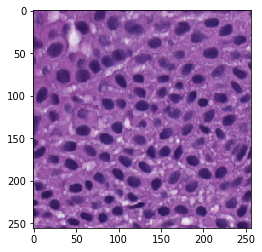

Blad_66.tif
0


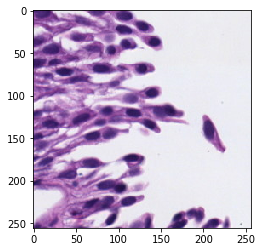

Blad_66.tif
0


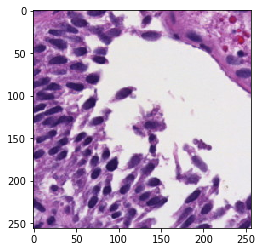

Blad_66.tif
0


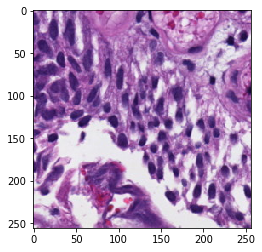

Blad_66.tif
0


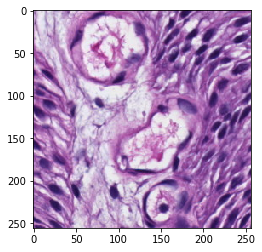

Blad_66.tif
0


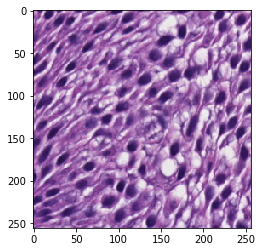

Blad_66.tif
0


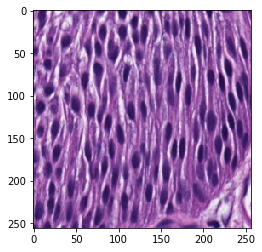

Blad_66.tif
0


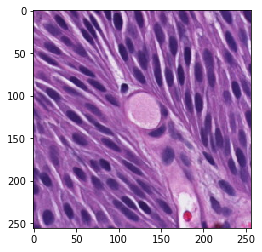

Blad_66.tif
0


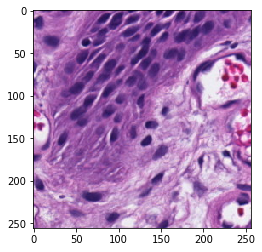

Blad_66.tif
0


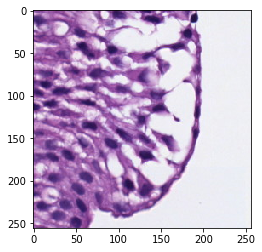

Blad_66.tif
0


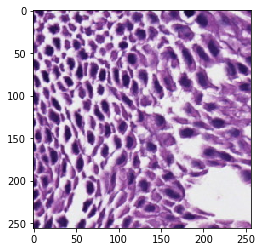

Blad_66.tif
0


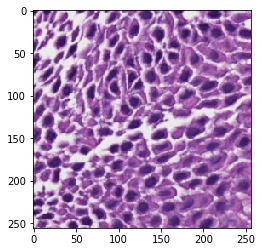

Blad_66.tif
0


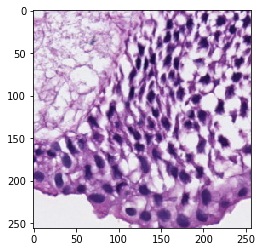

Blad_66.tif
0


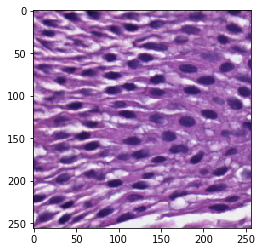

Blad_66.tif
0


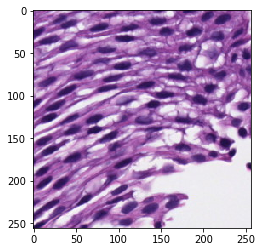

Blad_66.tif
0


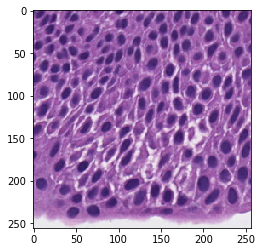

Blad_66.tif
0


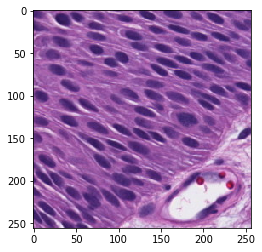

Blad_66.tif
0


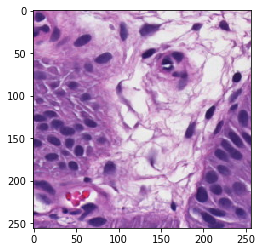

Blad_66.tif
0


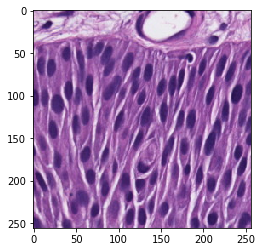

Blad_66.tif
0


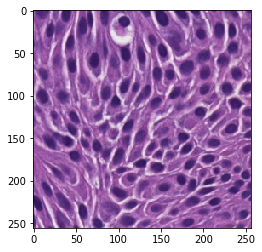

Blad_66.tif
0


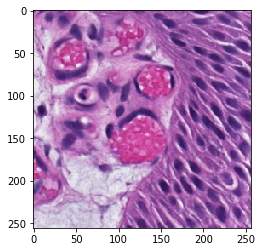

Blad_66.tif
0


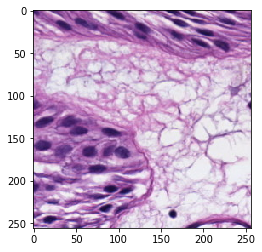

Blad_66.tif
0


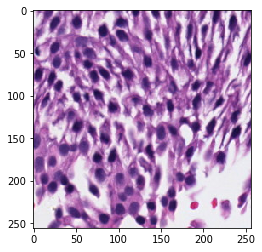


2it [00:18,  8.22s/it]

Blad_107.tif
1


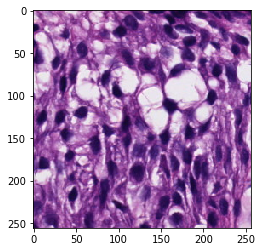

Blad_107.tif
1


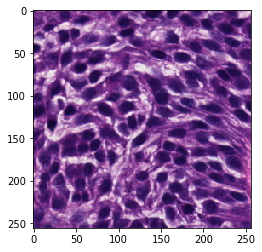

Blad_107.tif
1


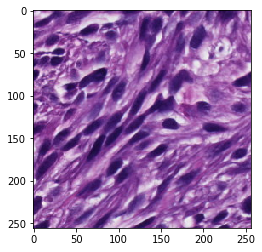

Blad_107.tif
1


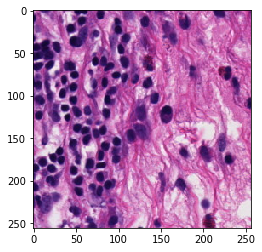

Blad_107.tif
1


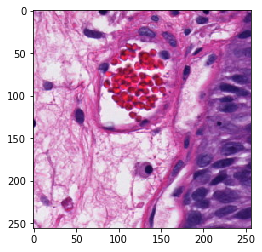

Blad_107.tif
1


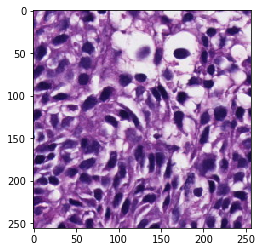

Blad_107.tif
1


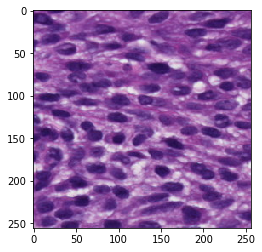

Blad_107.tif
1


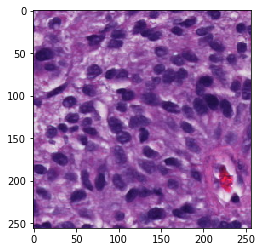

Blad_107.tif
1


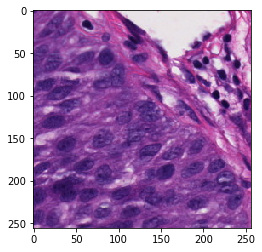

Blad_107.tif
1


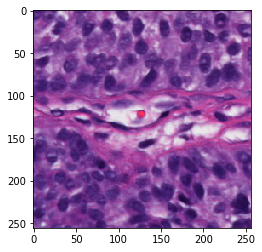

Blad_107.tif
1


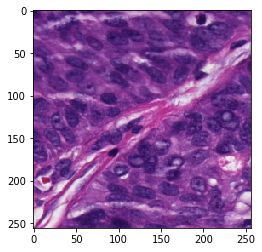

Blad_107.tif
1


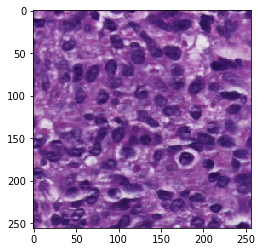

Blad_107.tif
1


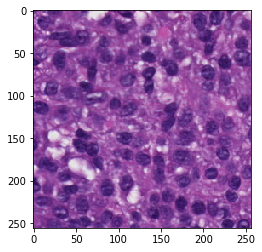

Blad_107.tif
1


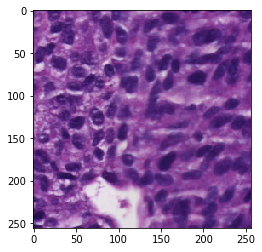

Blad_107.tif
1


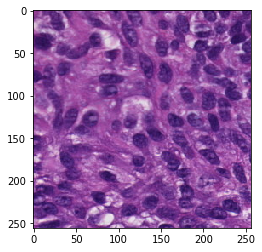

Blad_107.tif
1


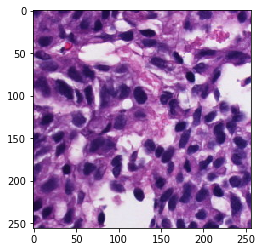

Blad_107.tif
1


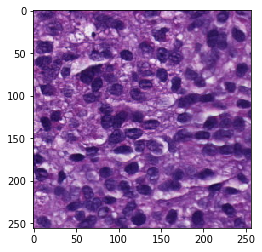

Blad_107.tif
1


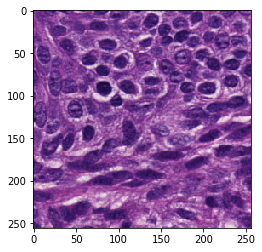

Blad_107.tif
1


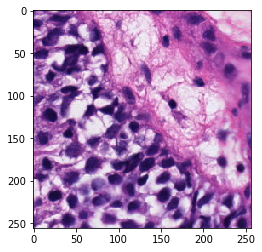

Blad_107.tif
1


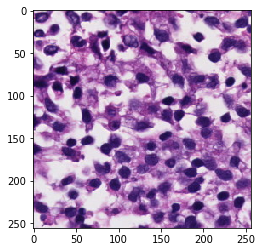

Blad_107.tif
1


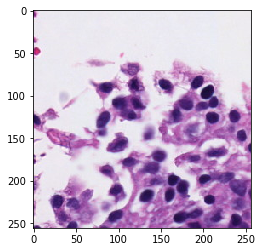

Blad_107.tif
1


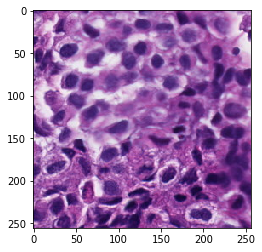

Blad_107.tif
1


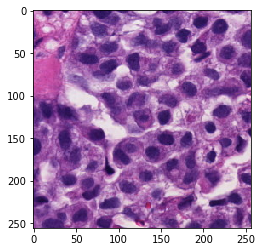

Blad_107.tif
1


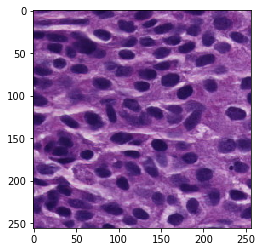

Blad_107.tif
1


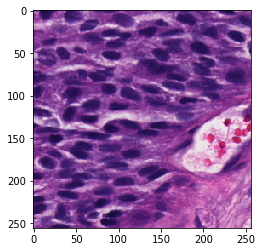

Blad_107.tif
1


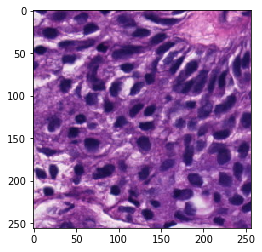

Blad_107.tif
1


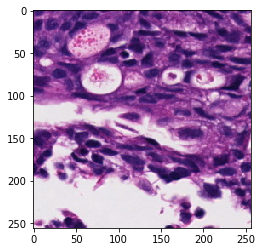


3it [00:27,  8.54s/it]

Blad_129.tif
1


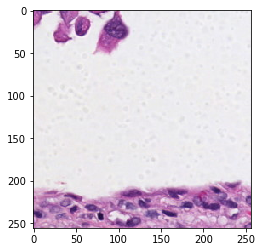

Blad_129.tif
1


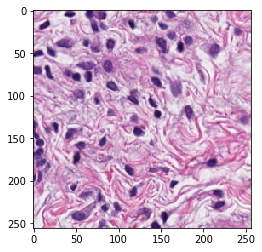

Blad_129.tif
1


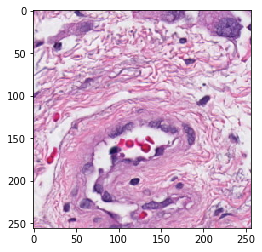

Blad_129.tif
1


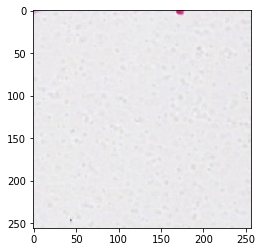

Blad_129.tif
1


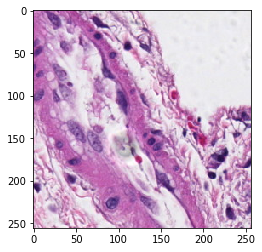

Blad_129.tif
1


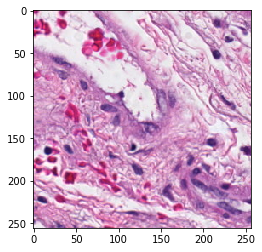

Blad_129.tif
1


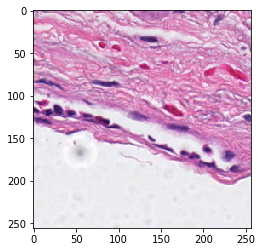

Blad_129.tif
1


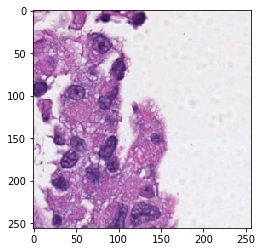

Blad_129.tif
1


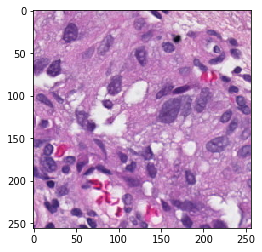

Blad_129.tif
1


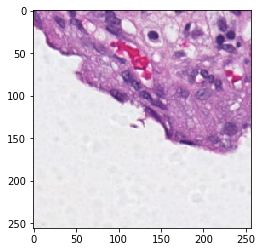


4it [00:31,  7.19s/it]

Blad_87.tif
1


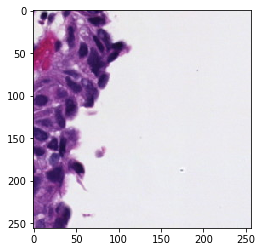

Blad_87.tif
1


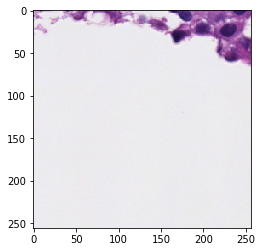


5it [00:32,  5.34s/it]

Blad_156.tif
1


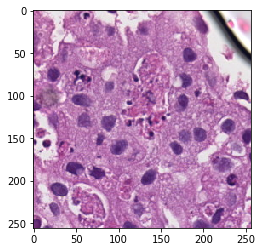

Blad_156.tif
1


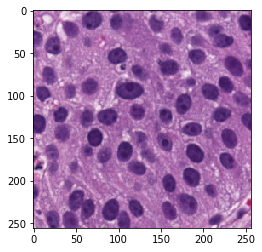

Blad_156.tif
1


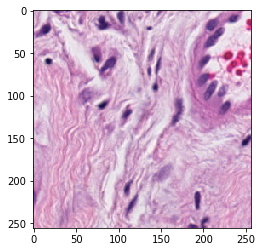

Blad_156.tif
1


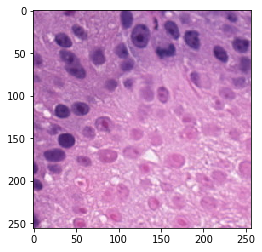


6it [00:34,  4.20s/it]

Blad_130.tif
0


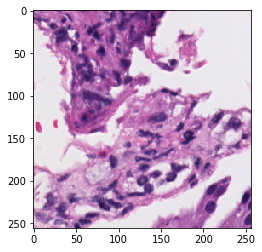

Blad_130.tif
0


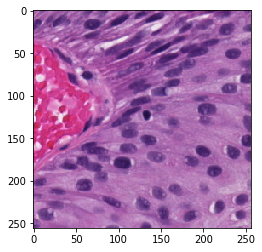

Blad_130.tif
0


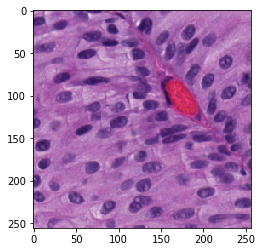

Blad_130.tif
0


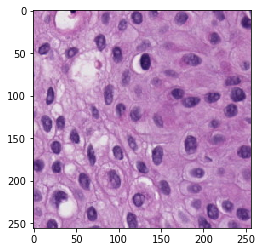

Blad_130.tif
0


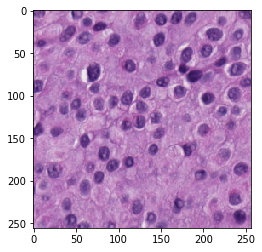

Blad_130.tif
0


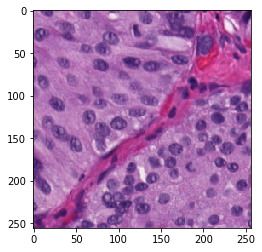

Blad_130.tif
0


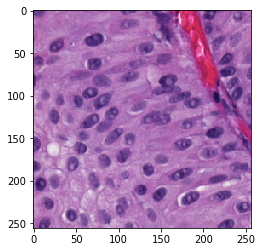

Blad_130.tif
0


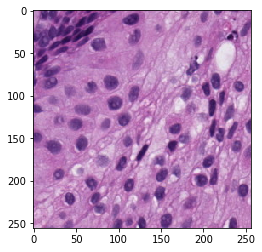

Blad_130.tif
0


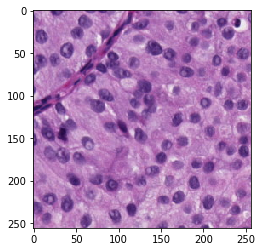

Blad_130.tif
0


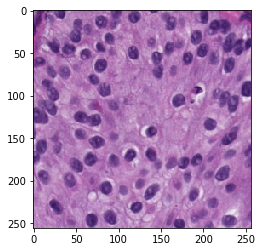

Blad_130.tif
0


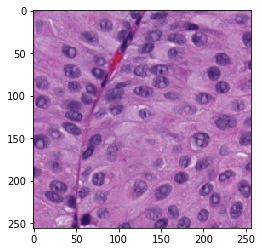

Blad_130.tif
0


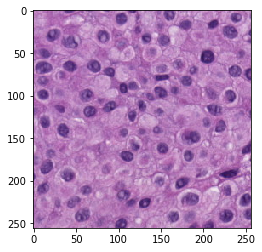

Blad_130.tif
0


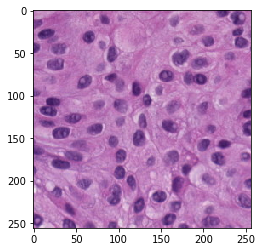

Blad_130.tif
0


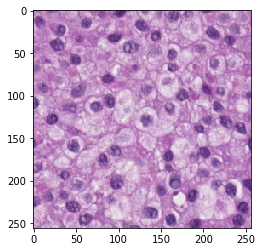

Blad_130.tif
0


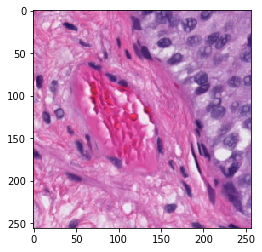

Blad_130.tif
0


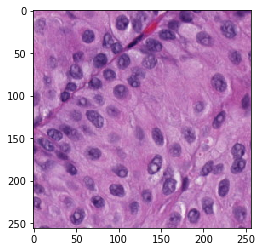

Blad_130.tif
0


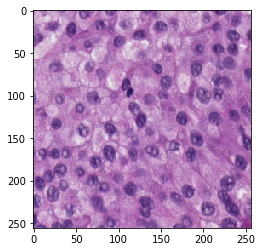

Blad_130.tif
0


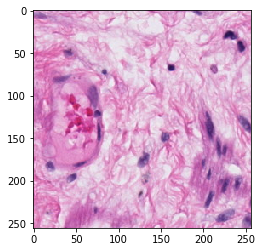

Blad_130.tif
0


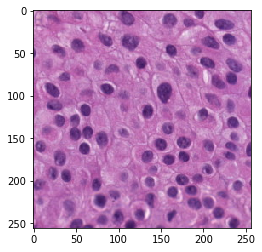

Blad_130.tif
0


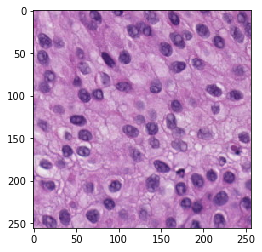

Blad_130.tif
0


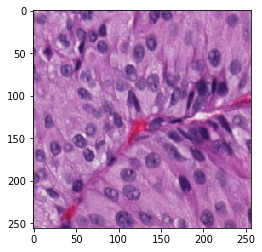

Blad_130.tif
0


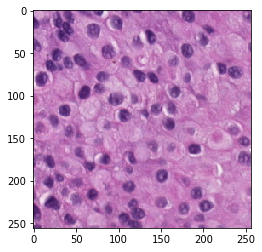

Blad_130.tif
0


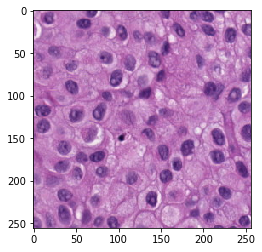

Blad_130.tif
0


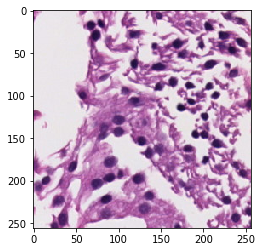

Blad_130.tif
0


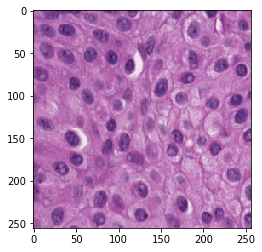

Blad_130.tif
0


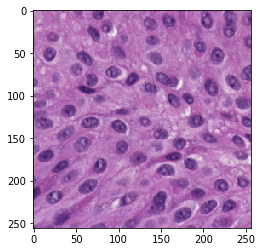

Blad_130.tif
0


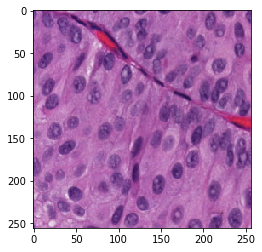

Blad_130.tif
0


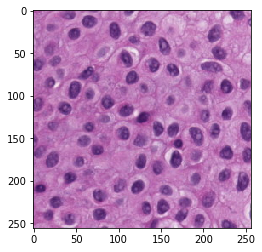


7it [00:46,  6.77s/it]

Blad_30.tif
0


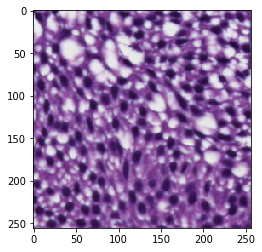

Blad_30.tif
0


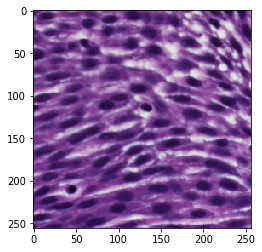

Blad_30.tif
0


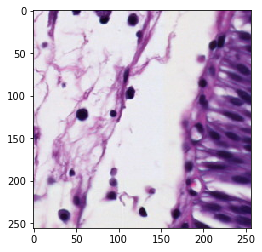

Blad_30.tif
0


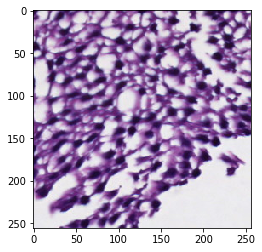

Blad_30.tif
0


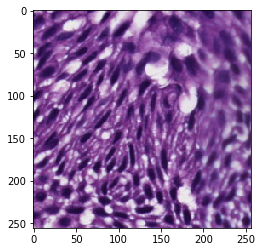

Blad_30.tif
0


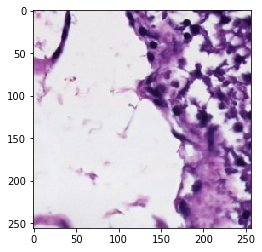

Blad_30.tif
0


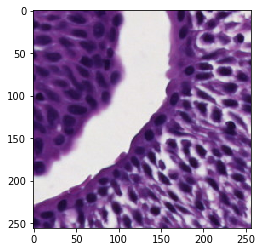

Blad_30.tif
0


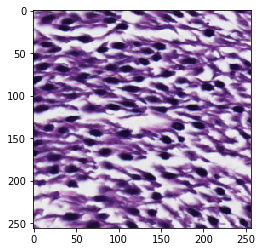

Blad_30.tif
0


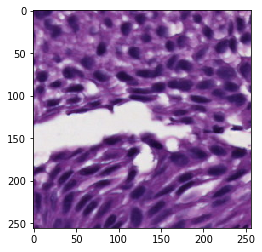

Blad_30.tif
0


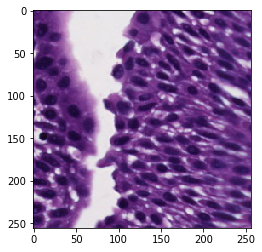

Blad_30.tif
0


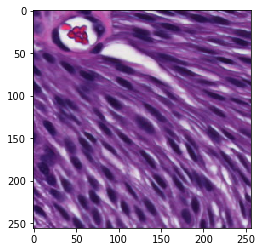

Blad_30.tif
0


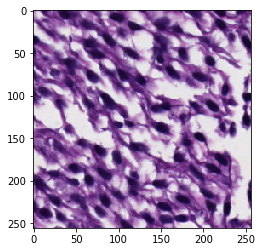

Blad_30.tif
0


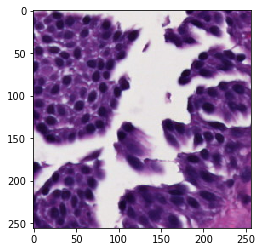

Blad_30.tif
0


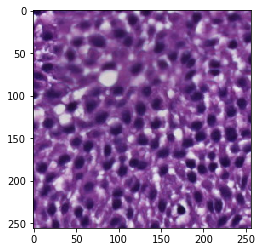

Blad_30.tif
0


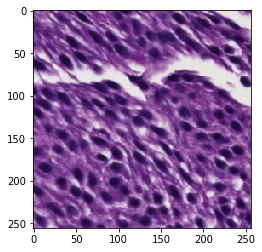

Blad_30.tif
0


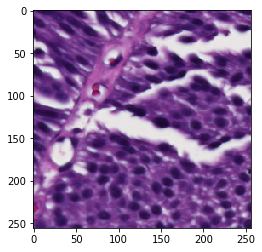

Blad_30.tif
0


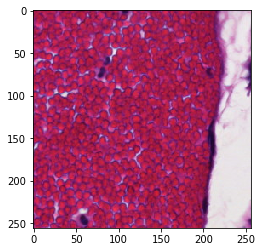

Blad_30.tif
0


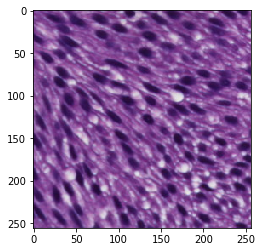

Blad_30.tif
0


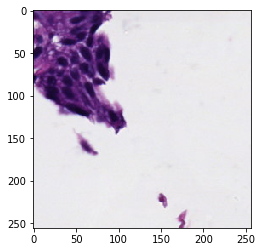

Blad_30.tif
0


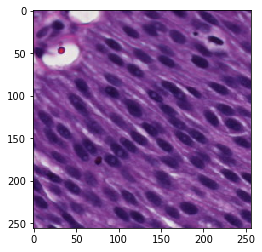

Blad_30.tif
0


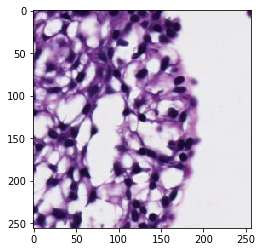

Blad_30.tif
0


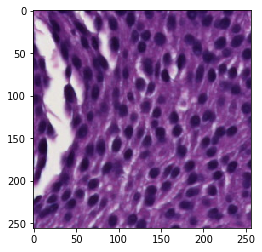

Blad_30.tif
0


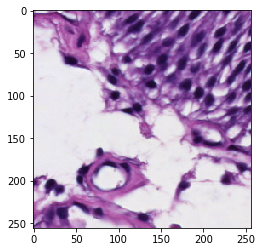

Blad_30.tif
0


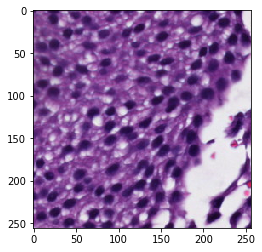

Blad_30.tif
0


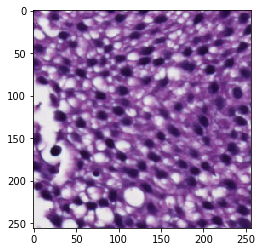

Blad_30.tif
0


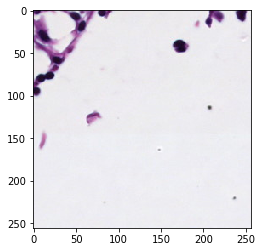

Blad_30.tif
0


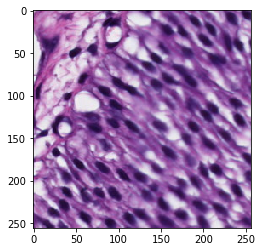

Blad_30.tif
0


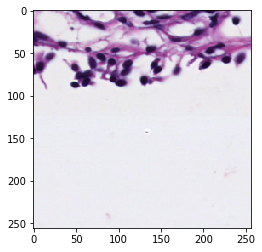

Blad_30.tif
0


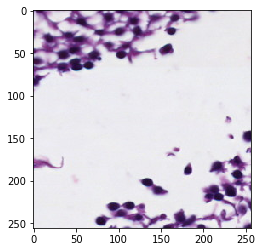


8it [01:00,  8.72s/it]

Blad_58.tif
1


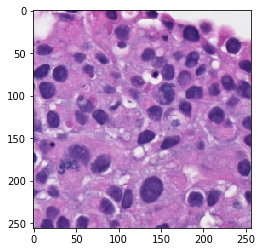

Blad_58.tif
1


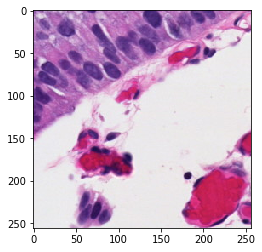


9it [01:01,  6.42s/it]

Blad_180.tif
0


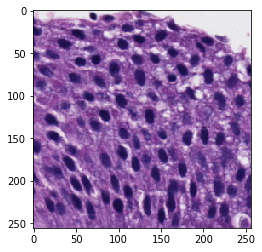

Blad_180.tif
0


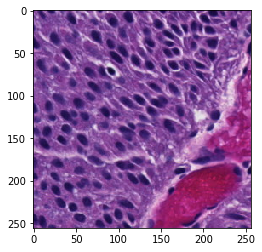

Blad_180.tif
0


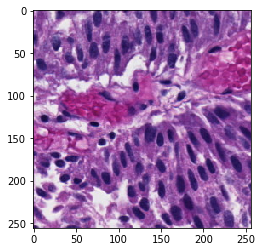

Blad_180.tif
0


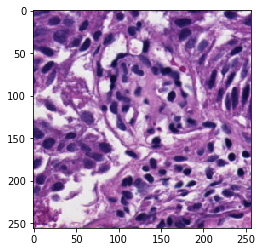

Blad_180.tif
0


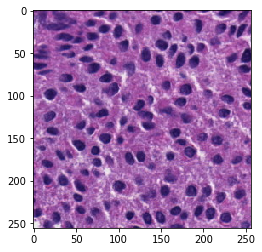

Blad_180.tif
0


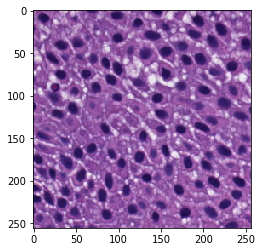

Blad_180.tif
0


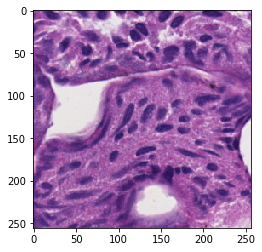


10it [01:04,  5.55s/it]

Blad_182.tif
0


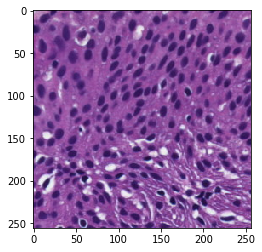

Blad_182.tif
0


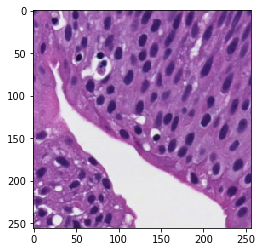

Blad_182.tif
0


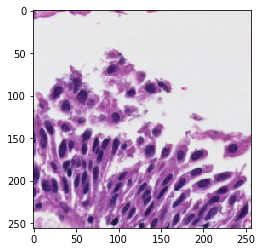

Blad_182.tif
0


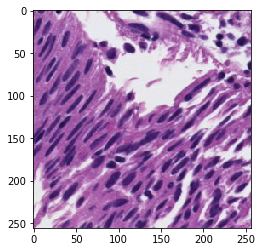

Blad_182.tif
0


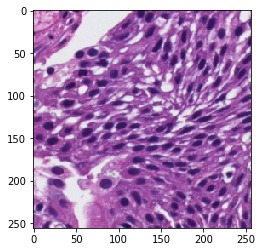

Blad_182.tif
0


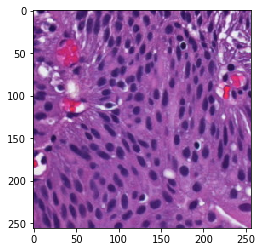

Blad_182.tif
0


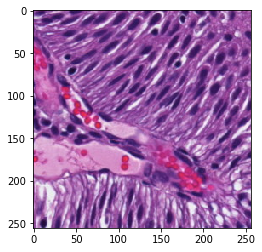

Blad_182.tif
0


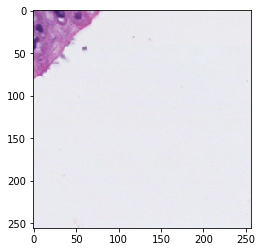

Blad_182.tif
0


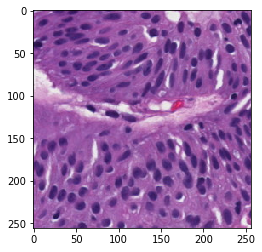

Blad_182.tif
0


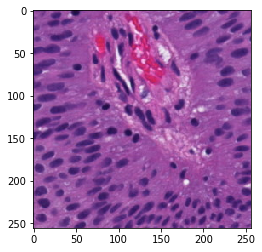

Blad_182.tif
0


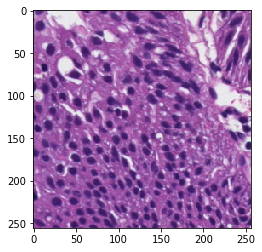

Blad_182.tif
0


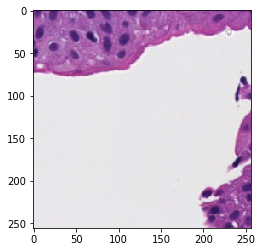

Blad_182.tif
0


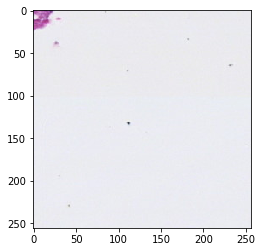

Blad_182.tif
0


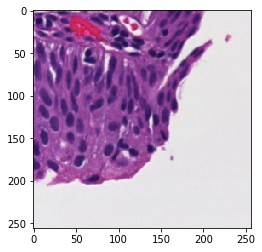


11it [01:11,  5.82s/it]

Blad_1.tif
1


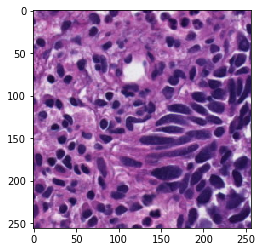

Blad_1.tif
1


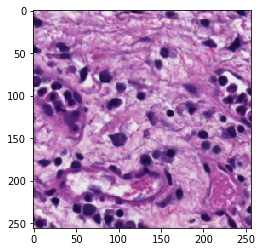

Blad_1.tif
1


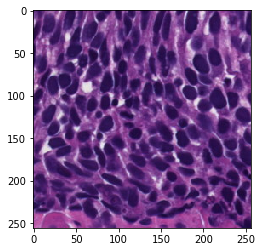


12it [01:12,  4.51s/it]

Blad_98.tif
1


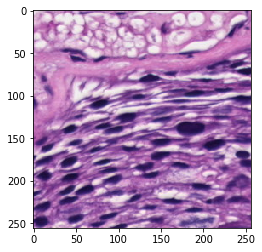

Blad_98.tif
1


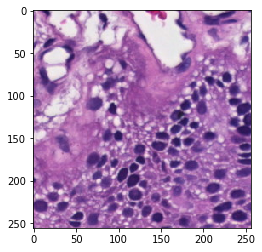

Blad_98.tif
1


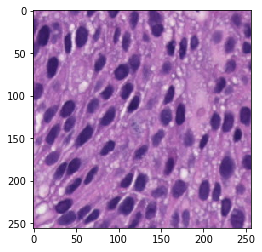

Blad_98.tif
1


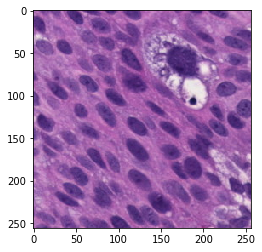

Blad_98.tif
1


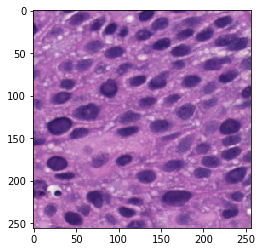

Blad_98.tif
1


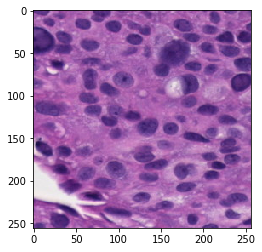

Blad_98.tif
1


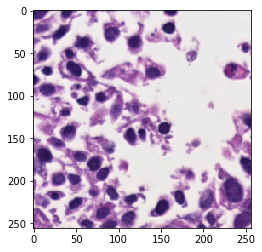

Blad_98.tif
1


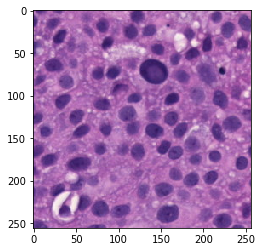

Blad_98.tif
1


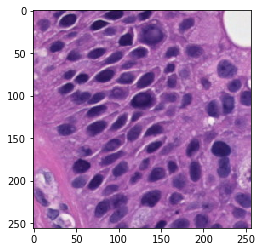

Blad_98.tif
1


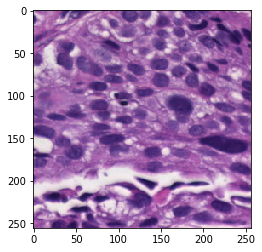

Blad_98.tif
1


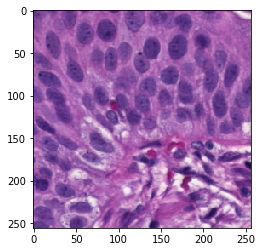

Blad_98.tif
1


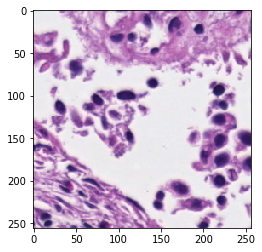

Blad_98.tif
1


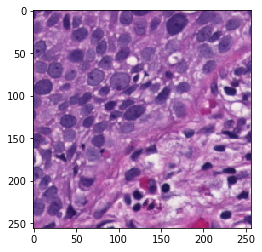

Blad_98.tif
1


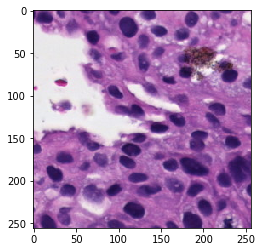

Blad_98.tif
1


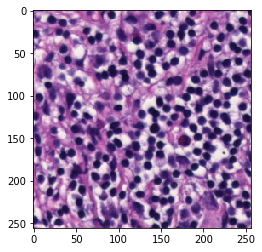

Blad_98.tif
1


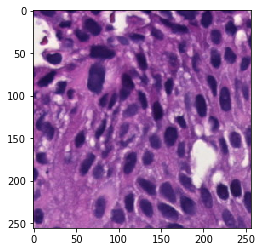

Blad_98.tif
1


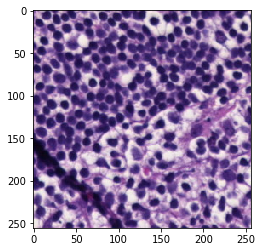

Blad_98.tif
1


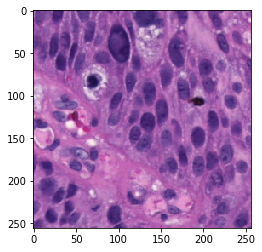

Blad_98.tif
1


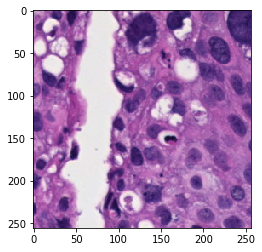

Blad_98.tif
1


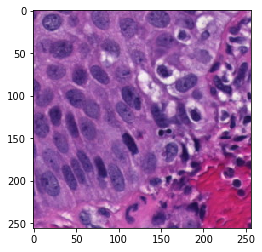

Blad_98.tif
1


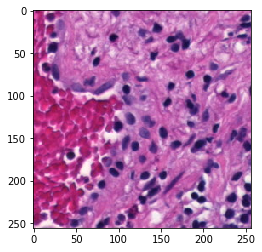

Blad_98.tif
1


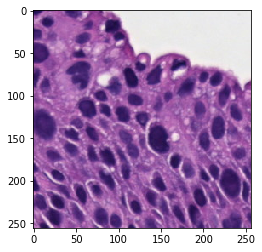

Blad_98.tif
1


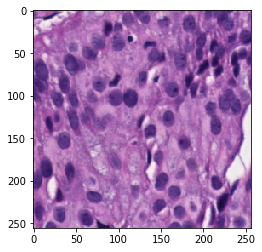

Blad_98.tif
1


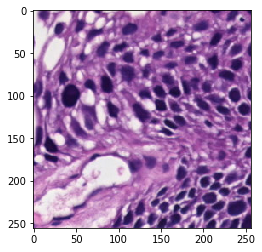

Blad_98.tif
1


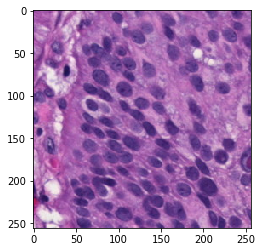

Blad_98.tif
1


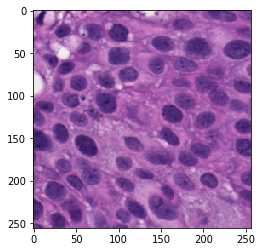

Blad_98.tif
1


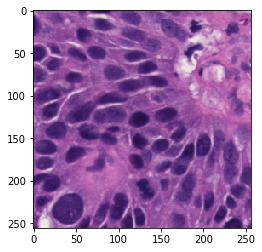

Blad_98.tif
1


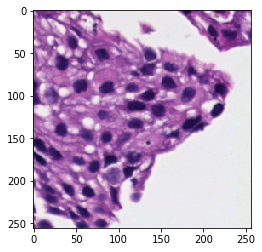

Blad_98.tif
1


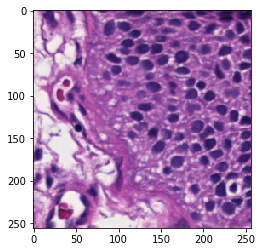

Blad_98.tif
1


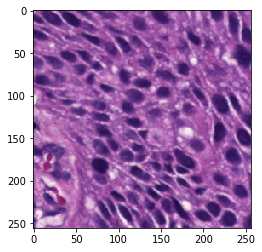

Blad_98.tif
1


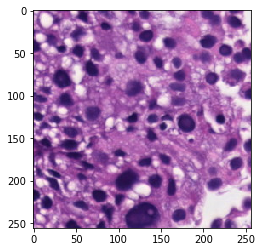


13it [01:26,  7.16s/it]

Blad_136.tif
1


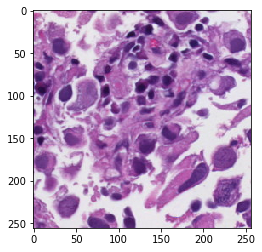

Blad_136.tif
1


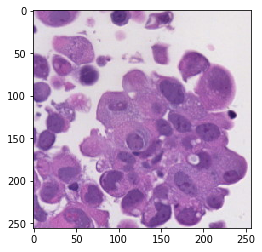

Blad_136.tif
1


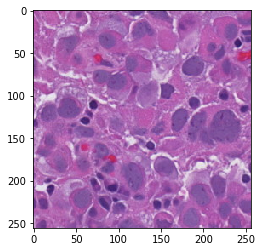

Blad_136.tif
1


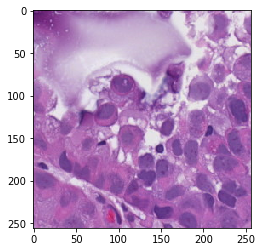

Blad_136.tif
1


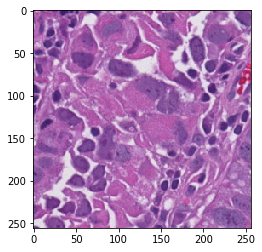

Blad_136.tif
1


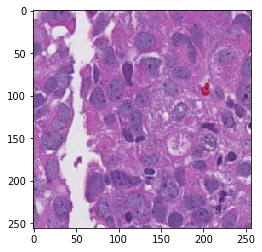

Blad_136.tif
1


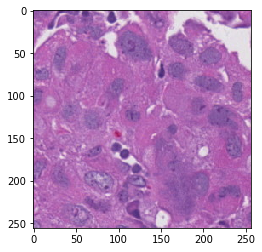

Blad_136.tif
1


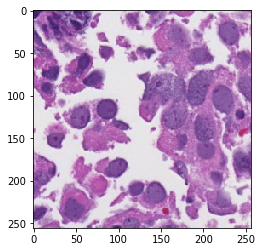

Blad_136.tif
1


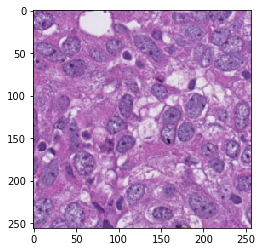

Blad_136.tif
1


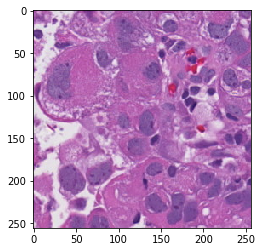

Blad_136.tif
1


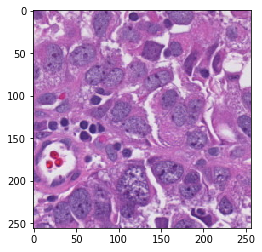

Blad_136.tif
1


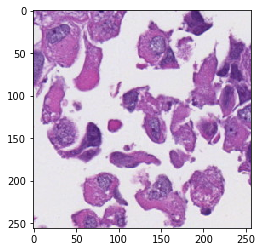

Blad_136.tif
1


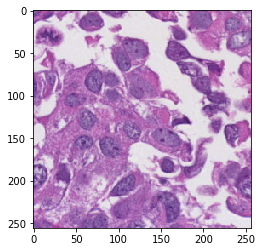


14it [01:31,  6.73s/it]

Blad_21.tif
0


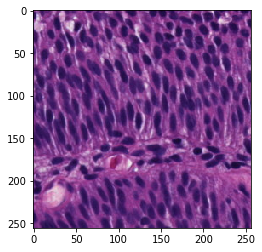

Blad_21.tif
0


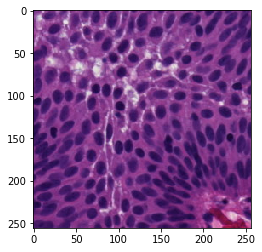

Blad_21.tif
0


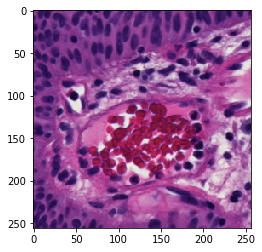

Blad_21.tif
0


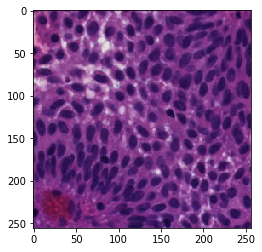

Blad_21.tif
0


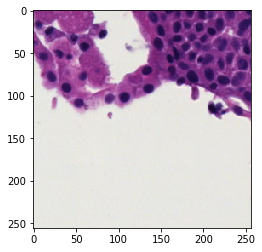

Blad_21.tif
0


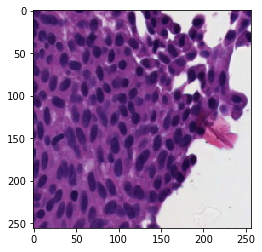

Blad_21.tif
0


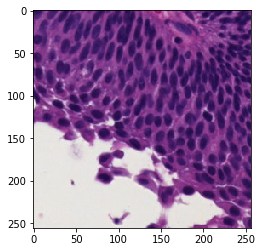

Blad_21.tif
0


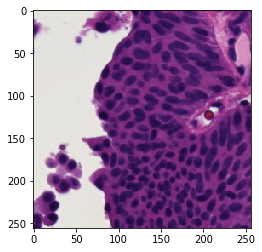

Blad_21.tif
0


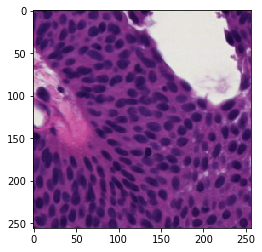

Blad_21.tif
0


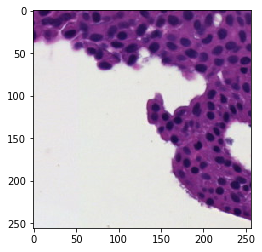

Blad_21.tif
0


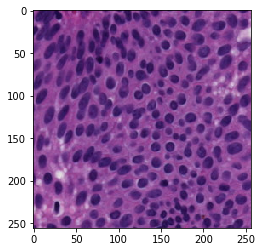

Blad_21.tif
0


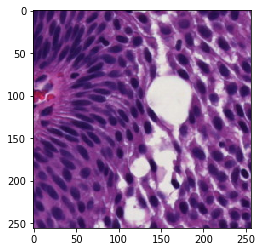

Blad_21.tif
0


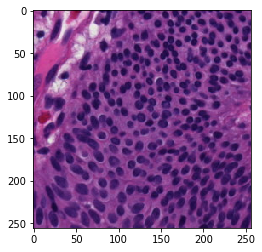

Blad_21.tif
0


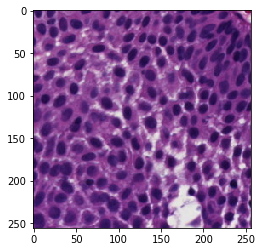

Blad_21.tif
0


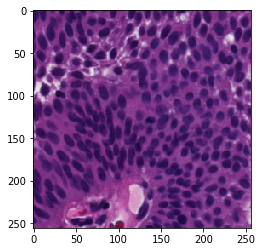

Blad_21.tif
0


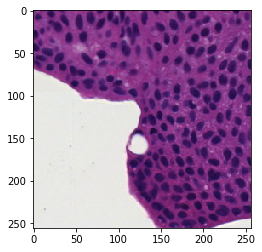

Blad_21.tif
0


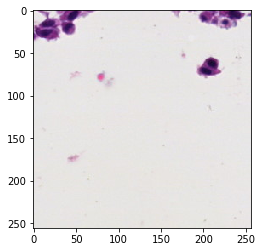


15it [01:38,  6.64s/it]

Blad_60.tif
1


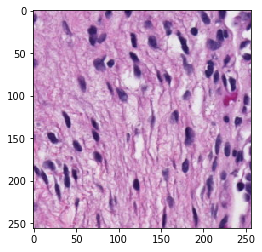

Blad_60.tif
1


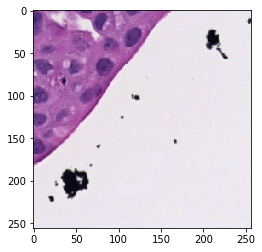


16it [01:39,  4.92s/it]

Blad_25.tif
1


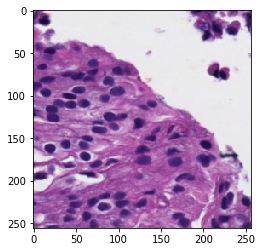

Blad_25.tif
1


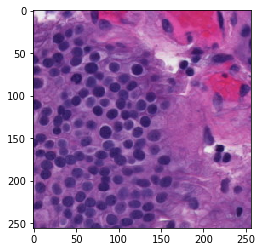

Blad_25.tif
1


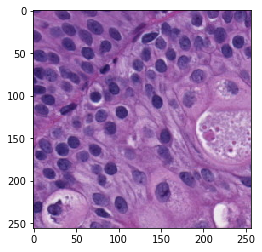

Blad_25.tif
1


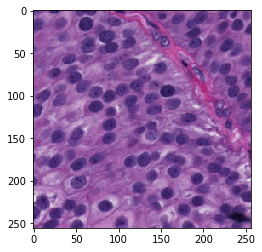

Blad_25.tif
1


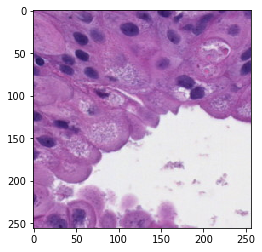

Blad_25.tif
1


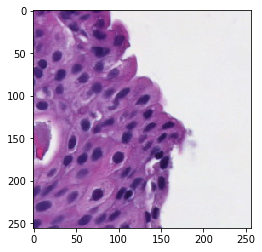

Blad_25.tif
1


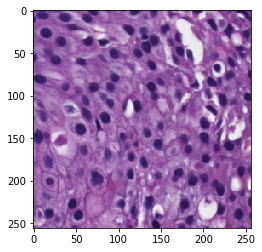

Blad_25.tif
1


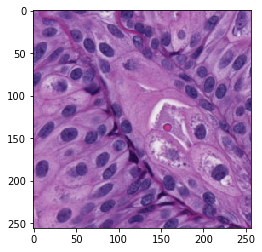

Blad_25.tif
1


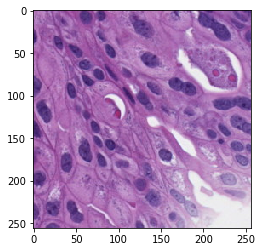

Blad_25.tif
1


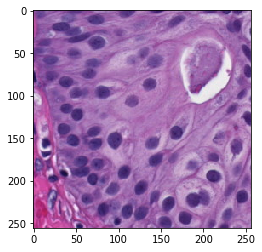

Blad_25.tif
1


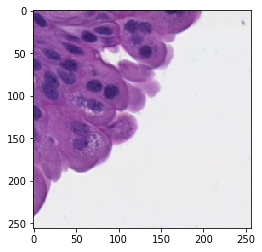

Blad_25.tif
1


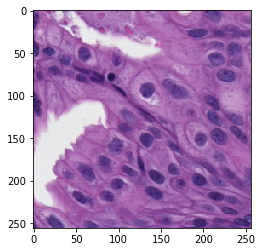

Blad_25.tif
1


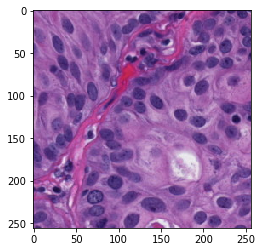

Blad_25.tif
1


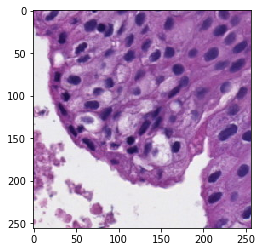

Blad_25.tif
1


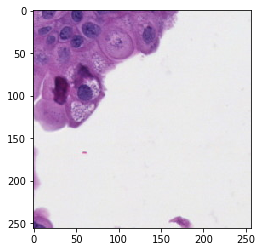

Blad_25.tif
1


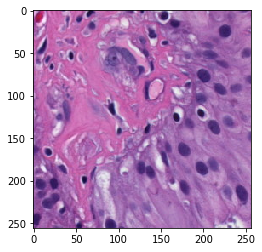

Blad_25.tif
1


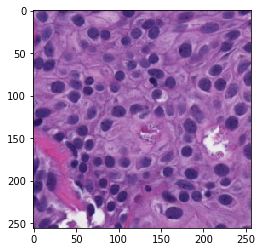

Blad_25.tif
1


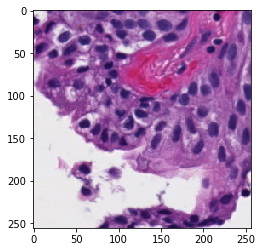

Blad_25.tif
1


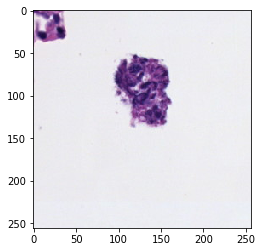

Blad_25.tif
1


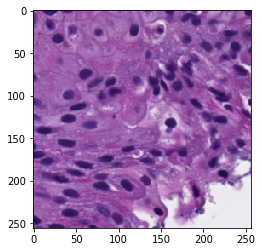

Blad_25.tif
1


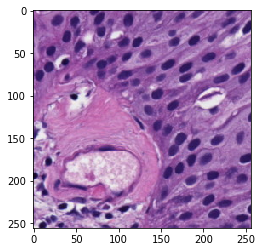


17it [01:48,  6.32s/it]

Blad_160.tif
0


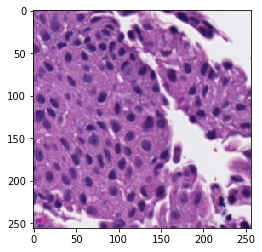


18it [01:49,  4.57s/it]

Blad_45.tif
1


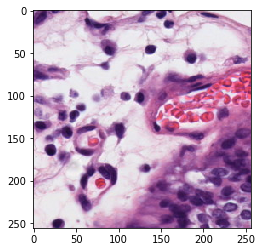

Blad_45.tif
1


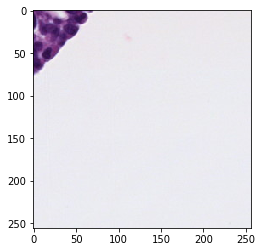

Blad_45.tif
1


KeyboardInterrupt: 

In [9]:
for index, wsi_img in tqdm.tqdm(enumerate(osis)):
        img_label = grade_key[wsi_img['img_fname'].split('/')[-1]]
        for rcidx in range(0,patch_counts[index]-1,100):            

            img = wsi_img.get_tile(desired_mpp=model_mpp,coords=(rscs[index][0][rcidx],rscs[index][1][rcidx]),wh=(patch_size,patch_size))        
            print(wsi_img['img_fname'].split('/')[-1])
            print(img_label)
            plt.imshow(img)
            plt.show()

useful reference
http://machinelearninguru.com/deep_learning/data_preparation/hdf5/hdf5.html